<a href="https://colab.research.google.com/github/khinydnlin/khinydnlin/blob/main/Fire%20False%20Alarm%20Predictions%20(London)/2023_London_Fire_False_Alarm_Predictions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 2023 London Fire False Alarm Predictions

The dataset for this study was sourced from the London Fire Brigade's official Incident Records. Government statistics from the UK for the year ending in September 2023 indicate that false fire alarms constitute 42% of the total reported incidents, incurring an estimated cost of £1 billion annually to the UK economy.

This project aims to develop a machine-learning classification model designed to predict the likelihood of incidents being fire false alarms in London. Our primary objective is to minimize the model's risk of overlooking actual incidents, while optimizing its capability to identify as many false alarms as possible. A key focus will be on achieving higher precision rates over recall rates to ensure accuracy in the identification of false alarms.

Previous studies and reports from the UK government suggest that the incidence of false alarms can significantly vary based on the source of the emergency call—distinguishing between automatic fire alarms (AFAs) and those initiated by individuals—as well as the type of property involved. This project will also explore these variables within our dataset to assess their impact and validate these findings.

1. Data Cleaning and EDA
    - Time Series Analysis
    - Location Analysis
    - General Analyis
    
2. Data Preprocessing and Feature Engineering

3. Model Exploration and Development

4. Model Improvement & Model Selection

In [94]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score,precision_score, recall_score, f1_score

#To surpress warnings
import warnings
warnings.filterwarnings('ignore')

In [95]:
fire_df = pd.read_csv('/content/sample_data/london_fire_incidents.csv',encoding = 'ISO-8859-1')

In [96]:
sns.set_palette('Set2')

In [97]:
fire_df.head()

IncidentNumber DateOfCall  CalYear TimeOfCall  HourOfCall  \
0  000001-01012023  01-Jan-23     2023   00:00:27           0   
1  000002-01012023  01-Jan-23     2023   00:02:58           0   
2  000003-01012023  01-Jan-23     2023   00:03:01           0   
3  000004-01012023  01-Jan-23     2023   00:04:19           0   
4  000005-01012023  01-Jan-23     2023   00:04:24           0   

     IncidentGroup        StopCodeDescription SpecialServiceType  \
0             Fire               Primary Fire                NaN   
1      False Alarm                        AFA                NaN   
2      False Alarm  False alarm - Good intent                NaN   
3             Fire             Secondary Fire                NaN   
4  Special Service            Special Service       Lift Release   

  PropertyCategory                                       PropertyType  ...  \
0     Road Vehicle             Towing caravan (not on tow or on site)  ...   
1  Non Residential                                  Pub/wine bar/bar   ...   
2         Dwelling                          House - single occupancy   ...   
3          Outdoor                                        Tree scrub   ...   
4         Dwelling  Purpose Built Flats/Maisonettes - 10 or more s...  ...   

  FirstPumpArriving_AttendanceTime FirstPumpArriving_DeployedFromStation  \
0                            378.0                                Heston   
1                            207.0                            Wandsworth   
2                            424.0                               Tooting   
3                            295.0                              Richmond   
4                            251.0                               Brixton   

  SecondPumpArriving_AttendanceTime  SecondPumpArriving_DeployedFromStation  \
0                             509.0                                  Heston   
1                               NaN                                     NaN   
2                             479.0                                 Tooting   
3                               NaN                                     NaN   
4                               NaN                                     NaN   

   NumStationsWithPumpsAttending NumPumpsAttending PumpCount  \
0                            3.0               4.0         4   
1                            1.0               1.0         1   
2                            1.0               2.0         2   
3                            1.0               1.0         1   
4                            1.0               1.0         1   

  PumpMinutesRounded Notional Cost (£) NumCalls  
0                169              1025      4.0  
1                 60               364      1.0  
2                 60               364      1.0  
3                 60               364      2.0  
4                 85               516      1.0  

[5 rows x 39 columns]

In [ ]:
Required packages
# !pip install itables
# !pip install folium

In [98]:
#To visualize the dataframe before conducting EDA

from itables import init_notebook_mode

init_notebook_mode(all_interactive = True)

In [99]:
from itables import show

show(
    fire_df,
     layout = {"top1": "searchBuilder"},
     searchBuilder = {
         "preDefined": {
             "criteria" : [
                 {"data" : "IncidentGroup" , "condition" : "=", "value" : ["Fire"]}
             ]
         }
     },
)

## 1. Data Cleaning and EDA

In [100]:
#Checking data types

fire_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 126472 entries, 0 to 126471
Data columns (total 39 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   IncidentNumber                          126472 non-null  object 
 1   DateOfCall                              126472 non-null  object 
 2   CalYear                                 126472 non-null  int64  
 3   TimeOfCall                              126472 non-null  object 
 4   HourOfCall                              126472 non-null  int64  
 5   IncidentGroup                           126472 non-null  object 
 6   StopCodeDescription                     126472 non-null  object 
 7   SpecialServiceType                      47343 non-null   object 
 8   PropertyCategory                        126472 non-null  object 
 9   PropertyType                            126472 non-null  object 
 10  AddressQualifier                        1264

### Initial Observations

### Potential Data Leakage

Upon initial observation, we can see that the dataset includes some variables which were collected post-incident. This means that incorporating them into our model will only lead to model overfitting. So, we should not include those variables in our predictive model as we won't have access to such information at the time of predicting.  Instead, we will filter the variables that are available before or during the time of prediction.

So, we decide to remove the following variables:
 - FRS (this refers to FireRescureService and it only has one category - London as the dataset was extracted for London only)
 - IncidentStationGround
 - FirstPumpArriving_AttendanceTime
 - FirstPumpArriving_DeployedFromStation
 - SecondPumpArriving_AttendanceTime
 - SecondPumpArriving_DeployedFromStation
 - NumStationsWithPumpsAttending
 - NumPumpsAttending
 - PumpCount
 - PumpMinutesRounded
 - Notional Cost (£)
 - NumCalls

StopDescriptionCode feature is a narrower categorisation of "Incident Types". It further breaks down the false alarms into "good intent", "malicious" and "due to apparatus (fire alarms/equipments)". The UK government statistics show that the false alarms caused by "due to apparatus" has increased by 6.8 % in 2023 compared to 2022. Although we can't know the intent of reported incidents in advance, I assume the LFB has a system to know whether the report comes from a fire alarm system or a person. Based on this assumption, we can create a new feature  to provide more information into our model.

### Missing Data

There are some columns with high missing values. For example, Special Service Type, a subset of Speacial Service category, has a high portion of null values because not all incidents require special service. We can in fact remove this variable as well as it is not relevant to false alarms.

### Redundant Data

Some columns are redundant. "HourOfCall" is extracted from "TimeOfCall". We can delete "HourOfCall" column. Similarly, "CalYear" is already captured in "DateOfCall". So we can remove that as well.

### Predictive Data

Information such as time, date, location can have predictive powers as the frequency of false alarms may be varied by time patterns. Simiarly, some locations may be prone to fire incidents/ false alarms.

In [101]:
fire_df_clean = fire_df.iloc[:, :-12].drop(["CalYear","HourOfCall","SpecialServiceType"],axis = 1)


fire_df_clean.head()

IncidentNumber DateOfCall TimeOfCall    IncidentGroup  \
0  000001-01012023  01-Jan-23   00:00:27             Fire   
1  000002-01012023  01-Jan-23   00:02:58      False Alarm   
2  000003-01012023  01-Jan-23   00:03:01      False Alarm   
3  000004-01012023  01-Jan-23   00:04:19             Fire   
4  000005-01012023  01-Jan-23   00:04:24  Special Service   

         StopCodeDescription PropertyCategory  \
0               Primary Fire     Road Vehicle   
1                        AFA  Non Residential   
2  False alarm - Good intent         Dwelling   
3             Secondary Fire          Outdoor   
4            Special Service         Dwelling   

                                        PropertyType  \
0             Towing caravan (not on tow or on site)   
1                                  Pub/wine bar/bar    
2                          House - single occupancy    
3                                        Tree scrub    
4  Purpose Built Flats/Maisonettes - 10 or more s...   

                   AddressQualifier Postcode_full Postcode_district  ...  \
0  On land associated with building       UB2 4NE               UB2  ...   
1              Within same building      SW18 2PT              SW18  ...   
2         Correct incident location           NaN               CR4  ...   
3  On land associated with building       TW9 1PB               TW9  ...   
4         Correct incident location           NaN               SW9  ...   

             ProperCase  IncGeo_WardCode  IncGeo_WardName IncGeo_WardNameNew  \
0                Ealing        E05013533    NORWOOD GREEN      NORWOOD GREEN   
1            Wandsworth        E05014028  WANDSWORTH TOWN    WANDSWORTH TOWN   
2                Merton        E05013815         GRAVENEY           GRAVENEY   
3  Richmond Upon thames        E05013786   SOUTH RICHMOND     SOUTH RICHMOND   
4               Lambeth        E05014096    BRIXTON NORTH      BRIXTON NORTH   

  Easting_m Northing_m Easting_rounded Northing_rounded   Latitude  Longitude  
0  514670.0   179437.0          514650           179450  51.502247  -0.349284  
1  525689.0   174615.0          525650           174650  51.456578  -0.192322  
2       NaN        NaN          528050           170250        NaN        NaN  
3  517552.0   174947.0          517550           174950  51.461307  -0.309263  
4       NaN        NaN          531050           176250        NaN        NaN  

[5 rows x 24 columns]

In [102]:
fire_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 126472 entries, 0 to 126471
Data columns (total 24 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   IncidentNumber       126472 non-null  object 
 1   DateOfCall           126472 non-null  object 
 2   TimeOfCall           126472 non-null  object 
 3   IncidentGroup        126472 non-null  object 
 4   StopCodeDescription  126472 non-null  object 
 5   PropertyCategory     126472 non-null  object 
 6   PropertyType         126472 non-null  object 
 7   AddressQualifier     126472 non-null  object 
 8   Postcode_full        52585 non-null   object 
 9   Postcode_district    126472 non-null  object 
 10  UPRN                 126472 non-null  float64
 11  USRN                 126472 non-null  int64  
 12  IncGeo_BoroughCode   126472 non-null  object 
 13  IncGeo_BoroughName   126472 non-null  object 
 14  ProperCase           126472 non-null  object 
 15  IncGeo_WardCode  

In [103]:
fire_df_clean.nunique()

IncidentNumber         126472
DateOfCall                365
TimeOfCall              63530
IncidentGroup               3
StopCodeDescription        10
PropertyCategory            9
PropertyType              273
AddressQualifier           11
Postcode_full           26223
Postcode_district         298
UPRN                    24082
USRN                    27471
IncGeo_BoroughCode         33
IncGeo_BoroughName         33
ProperCase                 33
IncGeo_WardCode           704
IncGeo_WardName           693
IncGeo_WardNameNew        693
Easting_m               26045
Northing_m              22325
Easting_rounded           554
Northing_rounded          443
Latitude                49170
Longitude               49235
dtype: int64

<Axes: ylabel='IncidentGroup'>

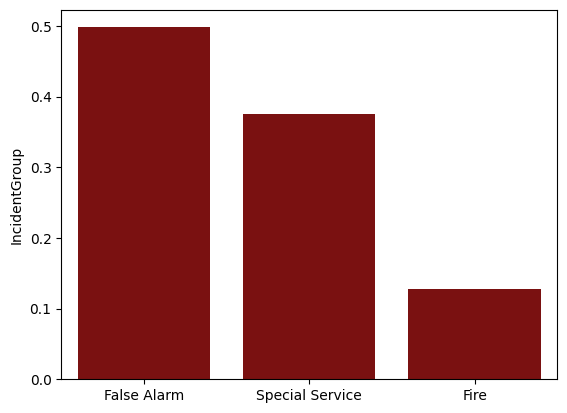

In [104]:
sns.barplot(data = fire_df_clean['IncidentGroup'].value_counts(normalize = True),color = 'darkred')

### Time Series Analysis

In [105]:
fire_df_clean['DateTime'] = fire_df_clean['DateOfCall'] + ' ' + fire_df_clean['TimeOfCall']

fire_df_clean['DateTime'] = pd.to_datetime(fire_df_clean['DateTime'], format = '%d-%b-%y %H:%M:%S')
fire_df_clean.head()

IncidentNumber DateOfCall TimeOfCall    IncidentGroup  \
0  000001-01012023  01-Jan-23   00:00:27             Fire   
1  000002-01012023  01-Jan-23   00:02:58      False Alarm   
2  000003-01012023  01-Jan-23   00:03:01      False Alarm   
3  000004-01012023  01-Jan-23   00:04:19             Fire   
4  000005-01012023  01-Jan-23   00:04:24  Special Service   

         StopCodeDescription PropertyCategory  \
0               Primary Fire     Road Vehicle   
1                        AFA  Non Residential   
2  False alarm - Good intent         Dwelling   
3             Secondary Fire          Outdoor   
4            Special Service         Dwelling   

                                        PropertyType  \
0             Towing caravan (not on tow or on site)   
1                                  Pub/wine bar/bar    
2                          House - single occupancy    
3                                        Tree scrub    
4  Purpose Built Flats/Maisonettes - 10 or more s...   

                   AddressQualifier Postcode_full Postcode_district  ...  \
0  On land associated with building       UB2 4NE               UB2  ...   
1              Within same building      SW18 2PT              SW18  ...   
2         Correct incident location           NaN               CR4  ...   
3  On land associated with building       TW9 1PB               TW9  ...   
4         Correct incident location           NaN               SW9  ...   

   IncGeo_WardCode  IncGeo_WardName IncGeo_WardNameNew Easting_m Northing_m  \
0        E05013533    NORWOOD GREEN      NORWOOD GREEN  514670.0   179437.0   
1        E05014028  WANDSWORTH TOWN    WANDSWORTH TOWN  525689.0   174615.0   
2        E05013815         GRAVENEY           GRAVENEY       NaN        NaN   
3        E05013786   SOUTH RICHMOND     SOUTH RICHMOND  517552.0   174947.0   
4        E05014096    BRIXTON NORTH      BRIXTON NORTH       NaN        NaN   

  Easting_rounded Northing_rounded   Latitude  Longitude            DateTime  
0          514650           179450  51.502247  -0.349284 2023-01-01 00:00:27  
1          525650           174650  51.456578  -0.192322 2023-01-01 00:02:58  
2          528050           170250        NaN        NaN 2023-01-01 00:03:01  
3          517550           174950  51.461307  -0.309263 2023-01-01 00:04:19  
4          531050           176250        NaN        NaN 2023-01-01 00:04:24  

[5 rows x 25 columns]

In [106]:
fire_df_clean = (fire_df_clean.assign(
    incident_year = fire_df_clean["DateTime"].dt.year,
    incident_month = fire_df_clean["DateTime"].dt.month,
    incident_dayofweek = fire_df_clean["DateTime"].dt.dayofweek,
    incident_day = fire_df_clean["DateTime"].dt.day,
    incident_hour = fire_df_clean["DateTime"].dt.hour,
    incident_minute = fire_df_clean["DateTime"].dt.minute)
).drop(['IncidentNumber','DateOfCall','TimeOfCall','DateTime'], axis = 1)

fire_df_clean.tail()

IncidentGroup        StopCodeDescription PropertyCategory  \
126467      False Alarm    False alarm - Malicious         Dwelling   
126468      False Alarm    False alarm - Malicious         Dwelling   
126469  Special Service            Special Service         Dwelling   
126470             Fire             Secondary Fire          Outdoor   
126471      False Alarm  False alarm - Good intent         Dwelling   

                                             PropertyType  \
126467  Purpose Built Flats/Maisonettes - Up to 3 stor...   
126468                          House - single occupancy    
126469                          House - single occupancy    
126470                                      Loose refuse    
126471                          House - single occupancy    

                            AddressQualifier Postcode_full Postcode_district  \
126467             Correct incident location           NaN               EN1   
126468             Correct incident location           NaN                E7   
126469                  Within same building           NaN               HA3   
126470  In street outside gazetteer location       UB2 4AL               UB2   
126471             Correct incident location           NaN              IG11   

              UPRN      USRN IncGeo_BoroughCode  ... Easting_rounded  \
126467         0.0  20705105          E09000010  ...          534050   
126468         0.0  22207800          E09000025  ...          539950   
126469         0.0  21201171          E09000015  ...          514050   
126470  12026799.0  20600918          E09000009  ...          512650   
126471         0.0  19900612          E09000002  ...          544850   

       Northing_rounded   Latitude Longitude incident_year  incident_month  \
126467           197950        NaN       NaN          2023              12   
126468           185450        NaN       NaN          2023              12   
126469           190650        NaN       NaN          2023              12   
126470           179650  51.504481  -0.37772          2023              12   
126471           184550        NaN       NaN          2023              12   

        incident_dayofweek  incident_day  incident_hour  incident_minute  
126467                   6            31             23               48  
126468                   6            31             23               50  
126469                   6            31             23               56  
126470                   6            31             23               59  
126471                   6            31             23               59  

[5 rows x 27 columns]

In [107]:
incidents_time_df = fire_df_clean[fire_df_clean["IncidentGroup"] == "False Alarm"].iloc[:, -6:]
incidents_time_df.head()

incident_year  incident_month  incident_dayofweek  incident_day  \
1            2023               1                   6             1   
2            2023               1                   6             1   
6            2023               1                   6             1   
11           2023               1                   6             1   
13           2023               1                   6             1   

    incident_hour  incident_minute  
1               0                2  
2               0                3  
6               0                9  
11              0               12  
13              0               13

In [110]:
incidents_time_df = pd.concat([fire_df_clean[['IncidentGroup']],fire_df_clean.iloc[:, -6:]],axis =1)
incidents_time_df.head()

IncidentGroup  incident_year  incident_month  incident_dayofweek  \
0             Fire           2023               1                   6   
1      False Alarm           2023               1                   6   
2      False Alarm           2023               1                   6   
3             Fire           2023               1                   6   
4  Special Service           2023               1                   6   

   incident_day  incident_hour  incident_minute  
0             1              0                0  
1             1              0                2  
2             1              0                3  
3             1              0                4  
4             1              0                4

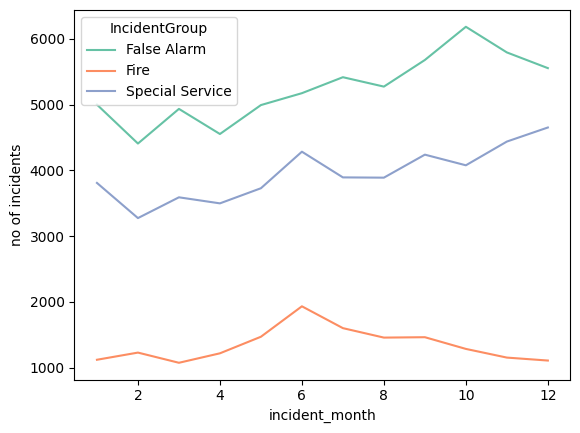

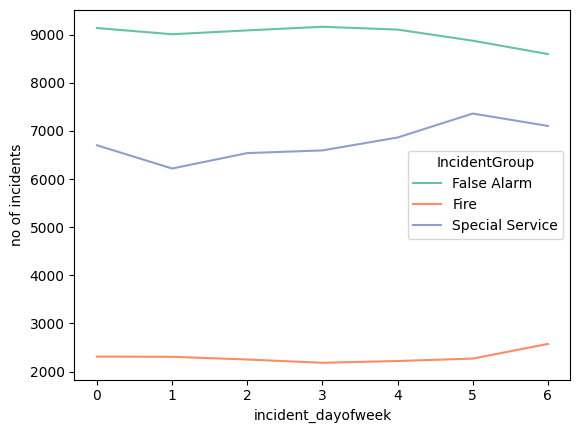

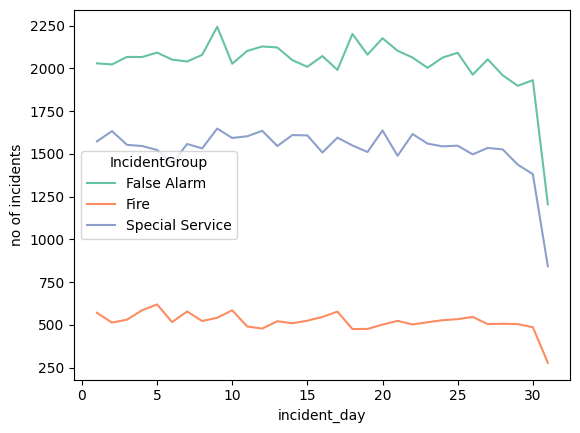

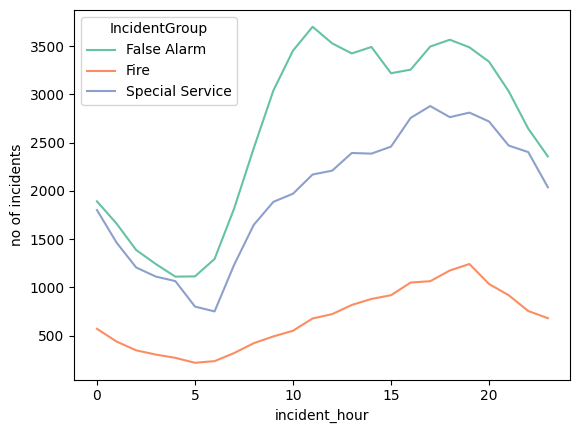

In [111]:
data = incidents_time_df.drop(['incident_year','incident_minute'], axis =1)

for feat in data.select_dtypes('int').columns:
    aggregate_data = data.groupby([feat, 'IncidentGroup']).size().reset_index(name ='no of incidents')
    sns.lineplot(data = aggregate_data, x = feat,y = 'no of incidents', hue = 'IncidentGroup')
    plt.show()

Although the incident rates seem to vary based on temporal patterns, both false alarms and actual acidents share similar trends. Therefore, time factors may not have high predictive value.

### Location Analysis

Location data has several missing values. We need to analyse if these missing values are systematically missing or random.

Amongst the location data, the following features have no missing values:

- Postcode_district
- UPRN
- USRN
- IncGeo_BoroughCode
- IncGeo_BoroughName
- ProperCase
- Easting_rounded
- Northing_rounded

In [112]:
fire_df_clean.isnull().sum()

IncidentGroup              0
StopCodeDescription        0
PropertyCategory           0
PropertyType               0
AddressQualifier           0
Postcode_full          73887
Postcode_district          0
UPRN                       0
USRN                       0
IncGeo_BoroughCode         0
IncGeo_BoroughName         0
ProperCase                 0
IncGeo_WardCode          214
IncGeo_WardName          214
IncGeo_WardNameNew       214
Easting_m              73887
Northing_m             73887
Easting_rounded            0
Northing_rounded           0
Latitude               73887
Longitude              73887
incident_year              0
incident_month             0
incident_dayofweek         0
incident_day               0
incident_hour              0
incident_minute            0
dtype: int64

In [31]:
import folium

location_df = fire_df_clean.dropna(subset = ['Latitude','Longitude'])

# create the map.
incidents_map = folium.Map(location=[51.5074,-0.1278],  tiles = "Cartodb Positron")

# adding the latitude and longitude points to the map.
location_df.apply(lambda row:folium.Circle(
    location=[row["Latitude"], row["Longitude"]],
    radius = 5,
    color = 'darkred',
    fill = False,
    fill_opacity = 0.4
).add_to(incidents_map), axis=1)

# display the map: just ask for the object representation in juypter notebook.
incidents_map


In [30]:
from matplotlib.colors import to_hex

location_fa_df = location_df[location_df['IncidentGroup'] == 'False Alarm']

borough_list = location_fa_df['IncGeo_BoroughName'].unique()
colormap = plt.cm.get_cmap('Set3', len(borough_list))

borough_colors = {borough: to_hex(colormap(i)) for i, borough in enumerate(borough_list)}

# create the map.
incidents_map = folium.Map(location=[51.5074,-0.1278], tiles = "Cartodb Positron")

# adding the latitude and longitude points to the map.
location_fa_df.apply(lambda row:folium.Circle(
    location=[row["Latitude"], row["Longitude"]],
    radius = 5,
    color = borough_colors[row['IncGeo_BoroughName']],
    fill = False,
    fill_opacity = 0.4
).add_to(incidents_map), axis=1)

# display the map
incidents_map

In [113]:
location_fa_df.head()

IncidentGroup        StopCodeDescription PropertyCategory  \
1    False Alarm                        AFA  Non Residential   
6    False Alarm                        AFA  Non Residential   
11   False Alarm  False alarm - Good intent  Non Residential   
13   False Alarm  False alarm - Good intent  Non Residential   
15   False Alarm  False alarm - Good intent          Outdoor   

         PropertyType                      AddressQualifier Postcode_full  \
1   Pub/wine bar/bar                   Within same building      SW18 2PT   
6    Secondary school             Correct incident location       N12 7NJ   
11     Church/Chapel              Correct incident location       EN3 5QH   
13            Prison              Correct incident location       W12 0AE   
15      Loose refuse   In street outside gazetteer location       IG1 1PU   

   Postcode_district          UPRN      USRN IncGeo_BoroughCode  ...  \
1               SW18  1.210087e+08  22905902          E09000032  ...   
6                N12  2.000842e+08  20030910          E09000003  ...   
11               EN3  2.071486e+08  20702265          E09000010  ...   
13               W12  3.402047e+07  21000285          E09000013  ...   
15               IG1  1.000220e+11  22302910          E09000026  ...   

   Easting_rounded Northing_rounded   Latitude Longitude incident_year  \
1           525650           174650  51.456578 -0.192322          2023   
6           526050           192150  51.614412 -0.180793          2023   
11          535350           198050  51.664826 -0.044516          2023   
13          522150           181350  51.517648 -0.240435          2023   
15          544250           185750  51.552430  0.079225          2023   

    incident_month  incident_dayofweek  incident_day  incident_hour  \
1                1                   6             1              0   
6                1                   6             1              0   
11               1                   6             1              0   
13               1                   6             1              0   
15               1                   6             1              0   

    incident_minute  
1                 2  
6                 9  
11               12  
13               13  
15               14  

[5 rows x 27 columns]

In [114]:
# Checking if null values of Location data are systematically missing or not
null_counts_by_group = fire_df_clean.groupby('AddressQualifier')['Longitude'].apply(lambda x: x.isnull().sum()).reset_index(name='Null_Counts')

null_counts_by_group


AddressQualifier  Null_Counts
0                         Correct incident location        52341
1             In street close to gazetteer location            0
2              In street outside gazetteer location            0
3          In street remote from gazetteer location            0
4            Nearby address - no building in street           54
5   Nearby address - street not listed in gazetteer           81
6                  On land associated with building          209
7                       On motorway / elevated road            0
8      Open land/water - nearest gazetteer location            1
9                     Railway land or rolling stock            0
10                             Within same building        21201

### General Analysis

As we have some initial insights on the incident types, we will create a target variable to dig deeper.

In [115]:
fire_df_clean['target'] = np.where(fire_df_clean['IncidentGroup'] == 'False Alarm', 1, 0)

In [116]:
fire_df_clean.head()

IncidentGroup        StopCodeDescription PropertyCategory  \
0             Fire               Primary Fire     Road Vehicle   
1      False Alarm                        AFA  Non Residential   
2      False Alarm  False alarm - Good intent         Dwelling   
3             Fire             Secondary Fire          Outdoor   
4  Special Service            Special Service         Dwelling   

                                        PropertyType  \
0             Towing caravan (not on tow or on site)   
1                                  Pub/wine bar/bar    
2                          House - single occupancy    
3                                        Tree scrub    
4  Purpose Built Flats/Maisonettes - 10 or more s...   

                   AddressQualifier Postcode_full Postcode_district  \
0  On land associated with building       UB2 4NE               UB2   
1              Within same building      SW18 2PT              SW18   
2         Correct incident location           NaN               CR4   
3  On land associated with building       TW9 1PB               TW9   
4         Correct incident location           NaN               SW9   

           UPRN      USRN IncGeo_BoroughCode  ... Northing_rounded   Latitude  \
0  1.214211e+07  20601925          E09000009  ...           179450  51.502247   
1  1.210087e+08  22905902          E09000032  ...           174650  51.456578   
2  0.000000e+00  22102898          E09000024  ...           170250        NaN   
3  1.000220e+11  22406188          E09000027  ...           174950  51.461307   
4  0.000000e+00  21901162          E09000022  ...           176250        NaN   

  Longitude incident_year incident_month  incident_dayofweek  incident_day  \
0 -0.349284          2023              1                   6             1   
1 -0.192322          2023              1                   6             1   
2       NaN          2023              1                   6             1   
3 -0.309263          2023              1                   6             1   
4       NaN          2023              1                   6             1   

   incident_hour  incident_minute  target  
0              0                0       0  
1              0                2       1  
2              0                3       1  
3              0                4       0  
4              0                4       0  

[5 rows x 28 columns]

<Axes: ylabel='target'>

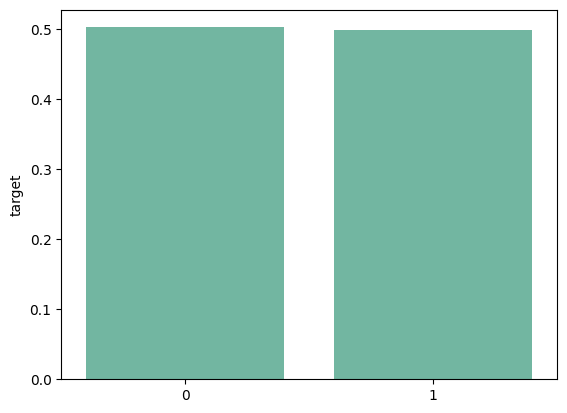

In [117]:
sns.barplot( data = fire_df_clean['target'].value_counts(normalize = True))

Since the target variable doesn't have class imbalance issues, we don't need to handle resampling techniques.

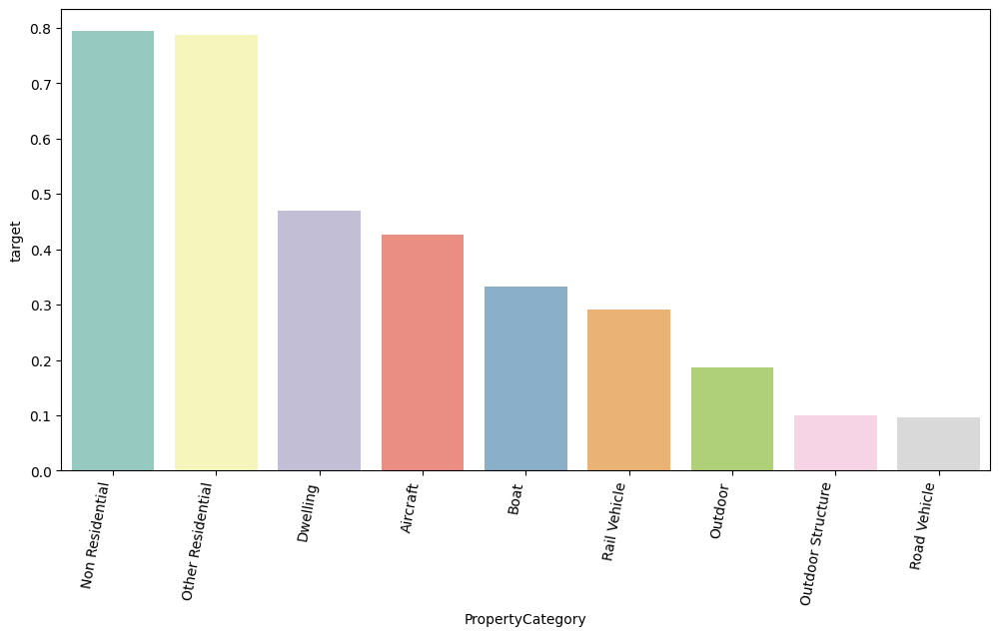

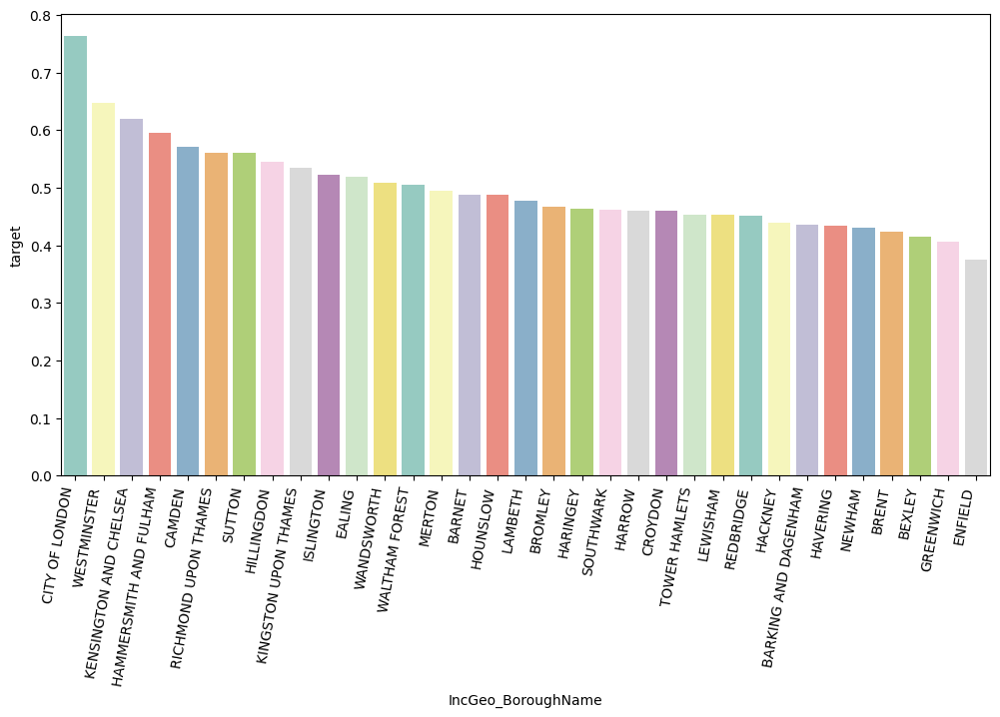

In [118]:
cat_data = fire_df_clean[['target','PropertyCategory','IncGeo_BoroughName']]

def cat_plotter(data,target, fig_width = 10, fig_height =  8):
    for col in data.select_dtypes(["object"]).columns:
        plt.figure(figsize = (fig_width,fig_height))
        sns.barplot(
            data=(
                data
                .groupby(col, as_index=False)
                .agg({"target": "mean"})
                .sort_values(by="target", ascending=False)
                 ),
            x=col,
            y=target,
            palette = 'Set3')
        plt.xticks(rotation=80, ha = 'right')
        plt.show()

cat_plotter(cat_data, "target", fig_width = 12, fig_height = 6)

In [119]:
fire_df_clean['StopCodeDescription'].value_counts()

AFA                                      49962
Special Service                          47301
False alarm - Good intent                11808
Primary Fire                              8451
Secondary Fire                            7642
False alarm - Malicious                   1208
Flood call attended - Batch mobilised       42
Use of Special Operations Room              40
Chimney Fire                                10
Late Call                                    8
Name: StopCodeDescription, dtype: int64

In [120]:
sums_by_group = fire_df_clean.groupby('StopCodeDescription')['target'].sum()
total_sum = sums_by_group.sum()
percentage = round((sums_by_group/total_sum) * 100, 2)
print(percentage)

StopCodeDescription
AFA                                      79.33
Chimney Fire                              0.00
False alarm - Good intent                18.75
False alarm - Malicious                   1.92
Flood call attended - Batch mobilised     0.00
Late Call                                 0.00
Primary Fire                              0.00
Secondary Fire                            0.00
Special Service                           0.00
Use of Special Operations Room            0.00
Name: target, dtype: float64


Although StopCodeDescription does not directly refer to source of call, we can guage the origin of call for False Alarms from this variable, assuming that we can distinguish the call at the time of prediction. Surprisingly, 80% of False Alarms come from AFA. This feature might have a high predictive power on false alarms.

## 2. Data Preprocessing and Feature Engineering

In [121]:
fire_df_clean.head()

IncidentGroup        StopCodeDescription PropertyCategory  \
0             Fire               Primary Fire     Road Vehicle   
1      False Alarm                        AFA  Non Residential   
2      False Alarm  False alarm - Good intent         Dwelling   
3             Fire             Secondary Fire          Outdoor   
4  Special Service            Special Service         Dwelling   

                                        PropertyType  \
0             Towing caravan (not on tow or on site)   
1                                  Pub/wine bar/bar    
2                          House - single occupancy    
3                                        Tree scrub    
4  Purpose Built Flats/Maisonettes - 10 or more s...   

                   AddressQualifier Postcode_full Postcode_district  \
0  On land associated with building       UB2 4NE               UB2   
1              Within same building      SW18 2PT              SW18   
2         Correct incident location           NaN               CR4   
3  On land associated with building       TW9 1PB               TW9   
4         Correct incident location           NaN               SW9   

           UPRN      USRN IncGeo_BoroughCode  ... Northing_rounded   Latitude  \
0  1.214211e+07  20601925          E09000009  ...           179450  51.502247   
1  1.210087e+08  22905902          E09000032  ...           174650  51.456578   
2  0.000000e+00  22102898          E09000024  ...           170250        NaN   
3  1.000220e+11  22406188          E09000027  ...           174950  51.461307   
4  0.000000e+00  21901162          E09000022  ...           176250        NaN   

  Longitude incident_year incident_month  incident_dayofweek  incident_day  \
0 -0.349284          2023              1                   6             1   
1 -0.192322          2023              1                   6             1   
2       NaN          2023              1                   6             1   
3 -0.309263          2023              1                   6             1   
4       NaN          2023              1                   6             1   

   incident_hour  incident_minute  target  
0              0                0       0  
1              0                2       1  
2              0                3       1  
3              0                4       0  
4              0                4       0  

[5 rows x 28 columns]

In [122]:
#Extracting source of call from 'StopCodeDescription' feature : AFA as AFA, Others as Non-AFA

def check_source_of_call(row):
    if 'afa' in row['StopCodeDescription'].lower():
        return 'AFA'
    else:
        return 'Non-AFA'

fire_df_clean['SourceOfCall'] = fire_df_clean.apply(check_source_of_call, axis = 1)
fire_df_clean.head()

IncidentGroup        StopCodeDescription PropertyCategory  \
0             Fire               Primary Fire     Road Vehicle   
1      False Alarm                        AFA  Non Residential   
2      False Alarm  False alarm - Good intent         Dwelling   
3             Fire             Secondary Fire          Outdoor   
4  Special Service            Special Service         Dwelling   

                                        PropertyType  \
0             Towing caravan (not on tow or on site)   
1                                  Pub/wine bar/bar    
2                          House - single occupancy    
3                                        Tree scrub    
4  Purpose Built Flats/Maisonettes - 10 or more s...   

                   AddressQualifier Postcode_full Postcode_district  \
0  On land associated with building       UB2 4NE               UB2   
1              Within same building      SW18 2PT              SW18   
2         Correct incident location           NaN               CR4   
3  On land associated with building       TW9 1PB               TW9   
4         Correct incident location           NaN               SW9   

           UPRN      USRN IncGeo_BoroughCode  ...   Latitude Longitude  \
0  1.214211e+07  20601925          E09000009  ...  51.502247 -0.349284   
1  1.210087e+08  22905902          E09000032  ...  51.456578 -0.192322   
2  0.000000e+00  22102898          E09000024  ...        NaN       NaN   
3  1.000220e+11  22406188          E09000027  ...  51.461307 -0.309263   
4  0.000000e+00  21901162          E09000022  ...        NaN       NaN   

  incident_year incident_month incident_dayofweek  incident_day  \
0          2023              1                  6             1   
1          2023              1                  6             1   
2          2023              1                  6             1   
3          2023              1                  6             1   
4          2023              1                  6             1   

   incident_hour  incident_minute  target  SourceOfCall  
0              0                0       0       Non-AFA  
1              0                2       1           AFA  
2              0                3       1       Non-AFA  
3              0                4       0       Non-AFA  
4              0                4       0       Non-AFA  

[5 rows x 29 columns]

In [123]:
drop_features = ['IncidentGroup',
                 'StopCodeDescription',
                 'PropertyType',
                 'AddressQualifier',
                 'Postcode_full',
                 'Postcode_district',
                 'UPRN',
                 'USRN',
                 'IncGeo_BoroughCode',
                 'ProperCase',
                 'IncGeo_WardCode',
                 'IncGeo_WardName',
                 'IncGeo_WardNameNew',
                 'Easting_m',
                 'Northing_m',
                 'Latitude',
                 'Longitude',
                 'incident_minute',
                 #'SourceOfCall', #we will test with and without this feature to gauge its influence on performance
                  ]

fire_df_prep = fire_df_clean.drop(drop_features, axis =1)
fire_df_prep = pd.get_dummies(fire_df_prep, drop_first = True, dtype = int)
fire_df_prep.head()

Easting_rounded  Northing_rounded  incident_year  incident_month  \
0           514650            179450           2023               1   
1           525650            174650           2023               1   
2           528050            170250           2023               1   
3           517550            174950           2023               1   
4           531050            176250           2023               1   

   incident_dayofweek  incident_day  incident_hour  target  \
0                   6             1              0       0   
1                   6             1              0       1   
2                   6             1              0       1   
3                   6             1              0       0   
4                   6             1              0       0   

   PropertyCategory_Boat  PropertyCategory_Dwelling  ...  \
0                      0                          0  ...   
1                      0                          0  ...   
2                      0                          1  ...   
3                      0                          0  ...   
4                      0                          1  ...   

   IncGeo_BoroughName_NEWHAM  IncGeo_BoroughName_REDBRIDGE  \
0                          0                             0   
1                          0                             0   
2                          0                             0   
3                          0                             0   
4                          0                             0   

   IncGeo_BoroughName_RICHMOND UPON THAMES  IncGeo_BoroughName_SOUTHWARK  \
0                                        0                             0   
1                                        0                             0   
2                                        0                             0   
3                                        1                             0   
4                                        0                             0   

   IncGeo_BoroughName_SUTTON  IncGeo_BoroughName_TOWER HAMLETS  \
0                          0                                 0   
1                          0                                 0   
2                          0                                 0   
3                          0                                 0   
4                          0                                 0   

   IncGeo_BoroughName_WALTHAM FOREST  IncGeo_BoroughName_WANDSWORTH  \
0                                  0                              0   
1                                  0                              1   
2                                  0                              0   
3                                  0                              0   
4                                  0                              0   

   IncGeo_BoroughName_WESTMINSTER  SourceOfCall_Non-AFA  
0                               0                     1  
1                               0                     0  
2                               0                     1  
3                               0                     1  
4                               0                     1  

[5 rows x 49 columns]

## 3. Model Exploration and Development

In [124]:
from sklearn.model_selection import train_test_split
#Splitting data

X = fire_df_prep.drop('target', axis =1)
y = fire_df_prep['target']

X_train,X_test,y_train,y_test = train_test_split(X,y, test_size = 0.2, random_state = 42)

In [129]:
X_train.head()

Easting_rounded  Northing_rounded  incident_year  incident_month  \
94159            507350            175850           2023              10   
61940            517250            192650           2023               7   
87441            524850            180750           2023               9   
100486           519250            189450           2023              10   
55112            533250            183150           2023               6   

        incident_dayofweek  incident_day  incident_hour  \
94159                    4             6             12   
61940                    5             8             14   
87441                    0            18              0   
100486                   6            22             19   
55112                    0            19             21   

        PropertyCategory_Boat  PropertyCategory_Dwelling  \
94159                       0                          0   
61940                       0                          0   
87441                       0                          1   
100486                      0                          0   
55112                       0                          0   

        PropertyCategory_Non Residential  ...  IncGeo_BoroughName_NEWHAM  \
94159                                  0  ...                          0   
61940                                  0  ...                          0   
87441                                  0  ...                          0   
100486                                 1  ...                          0   
55112                                  1  ...                          0   

        IncGeo_BoroughName_REDBRIDGE  IncGeo_BoroughName_RICHMOND UPON THAMES  \
94159                              0                                        0   
61940                              0                                        0   
87441                              0                                        0   
100486                             0                                        0   
55112                              0                                        0   

        IncGeo_BoroughName_SOUTHWARK  IncGeo_BoroughName_SUTTON  \
94159                              0                          0   
61940                              0                          0   
87441                              0                          0   
100486                             0                          0   
55112                              0                          0   

        IncGeo_BoroughName_TOWER HAMLETS  IncGeo_BoroughName_WALTHAM FOREST  \
94159                                  0                                  0   
61940                                  0                                  0   
87441                                  0                                  0   
100486                                 0                                  0   
55112                                  0                                  0   

        IncGeo_BoroughName_WANDSWORTH  IncGeo_BoroughName_WESTMINSTER  \
94159                               0                               0   
61940                               0                               0   
87441                               0                               0   
100486                              0                               0   
55112                               0                               0   

        SourceOfCall_Non-AFA  
94159                      1  
61940                      0  
87441                      1  
100486                     1  
55112                      0  

[5 rows x 48 columns]

In [130]:
y_train.head()

94159     0
61940     1
87441     0
100486    0
55112     1
Name: target, dtype: int64

In [125]:
X_train.shape

(101177, 48)

In [126]:
y_train.shape

(101177,)

In [134]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

lr = LogisticRegression(penalty = 'l2', random_state = 42, solver = 'lbfgs', max_iter =100)

lr.fit(X_train,y_train)

print(classification_report(y_train,lr.predict(X_train)))
print(classification_report(y_test,lr.predict(X_test)))

              precision    recall  f1-score   support

           0       0.49      0.68      0.57     50633
           1       0.47      0.28      0.35     50544

    accuracy                           0.48    101177
   macro avg       0.48      0.48      0.46    101177
weighted avg       0.48      0.48      0.46    101177

              precision    recall  f1-score   support

           0       0.50      0.68      0.58     12861
           1       0.46      0.28      0.35     12434

    accuracy                           0.49     25295
   macro avg       0.48      0.48      0.46     25295
weighted avg       0.48      0.49      0.47     25295



In [128]:
print(accuracy_score(y_train,lr.predict(X_train)))
print(accuracy_score(y_test,lr.predict(X_test)))

0.4827480553880823
0.48701324372405613


[Text(0.5, 23.52222222222222, 'Predictions'),
 Text(50.72222222222221, 0.5, 'Actual'),
 Text(0.5, 1.0, 'Logistic Confusion Matrix')]

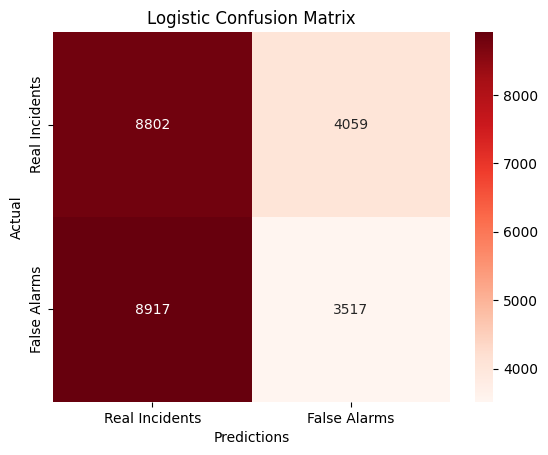

In [51]:
from sklearn.metrics import confusion_matrix

sns.heatmap(
    data = confusion_matrix(y_test, lr.predict(X_test)),
    cmap = 'Reds',
    annot = True,
    fmt = 'g',
    xticklabels = ['Real Incidents','False Alarms'],
    yticklabels = ['Real Incidents','False Alarms'],
).set(
    xlabel = 'Predictions',
    ylabel = 'Actual',
    title = 'Logistic Confusion Matrix')

In [52]:
from sklearn.preprocessing import StandardScaler

std = StandardScaler()

X_train_std = std.fit_transform(X_train)
X_test_std = std.transform(X_test)

In [60]:
knn = KNeighborsClassifier()

knn.fit(X_train_std,y_train)

print(classification_report(y_train,knn.predict(X_train_std)))
print(classification_report(y_test,knn.predict(X_test_std)))

              precision    recall  f1-score   support

           0       0.85      0.98      0.91     50633
           1       0.97      0.83      0.90     50544

    accuracy                           0.91    101177
   macro avg       0.91      0.91      0.90    101177
weighted avg       0.91      0.91      0.90    101177

              precision    recall  f1-score   support

           0       0.84      0.95      0.89     12861
           1       0.95      0.81      0.87     12434

    accuracy                           0.88     25295
   macro avg       0.89      0.88      0.88     25295
weighted avg       0.89      0.88      0.88     25295



In [57]:
print(accuracy_score(y_train,knn.predict(X_train_std)))
print(accuracy_score(y_test, knn.predict(X_test_std)))

0.9051661938978226
0.8841668313896027


[Text(0.5, 23.52222222222222, 'Predictions'),
 Text(50.72222222222221, 0.5, 'Actual'),
 Text(0.5, 1.0, 'KNN Confusion Matrix')]

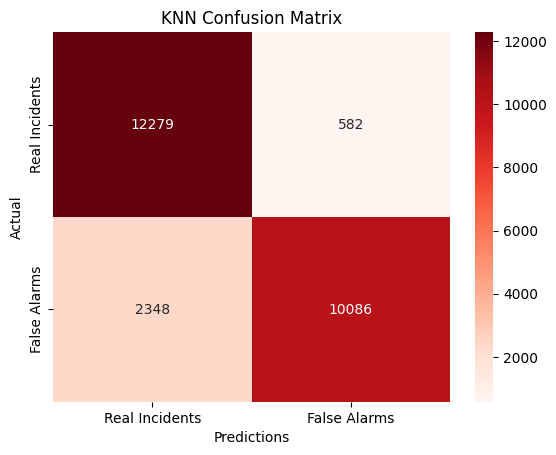

In [59]:
sns.heatmap(
    data = confusion_matrix(y_test, knn.predict(X_test_std)),
    cmap = 'Reds',
    annot = True,
    fmt = 'g',
    xticklabels = ['Real Incidents','False Alarms'],
    yticklabels = ['Real Incidents','False Alarms'],
).set(
    xlabel = 'Predictions',
    ylabel = 'Actual',
    title = 'KNN Confusion Matrix')

In [61]:
from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()

gnb.fit(X_train,y_train)

print(classification_report(y_train,gnb.predict(X_train)))
print(classification_report(y_test, gnb.predict(X_test)))

              precision    recall  f1-score   support

           0       0.84      0.91      0.87     50633
           1       0.91      0.82      0.86     50544

    accuracy                           0.87    101177
   macro avg       0.87      0.87      0.87    101177
weighted avg       0.87      0.87      0.87    101177

              precision    recall  f1-score   support

           0       0.85      0.91      0.88     12861
           1       0.90      0.83      0.86     12434

    accuracy                           0.87     25295
   macro avg       0.87      0.87      0.87     25295
weighted avg       0.87      0.87      0.87     25295



In [62]:
print(accuracy_score(y_train,gnb.predict(X_train)))
print(accuracy_score(y_test, gnb.predict(X_test)))

0.8684681301086216
0.8714370428938525


[Text(0.5, 23.52222222222222, 'Predictions'),
 Text(50.72222222222221, 0.5, 'Actual'),
 Text(0.5, 1.0, 'Gaussian Confusion Matrix')]

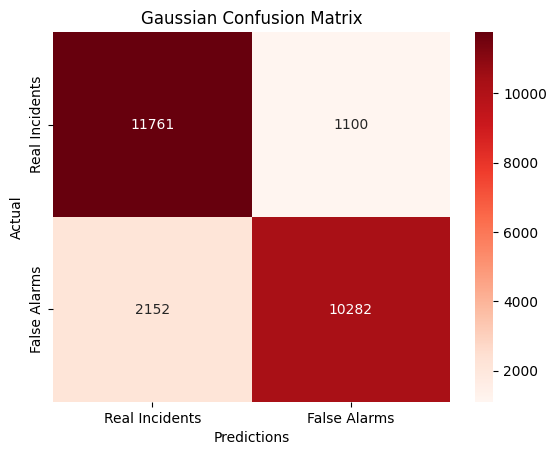

In [63]:
sns.heatmap(
    data = confusion_matrix(y_test, gnb.predict(X_test)),
    cmap = 'Reds',
    annot = True,
    fmt = 'g',
    xticklabels = ['Real Incidents','False Alarms'],
    yticklabels = ['Real Incidents','False Alarms'],
).set(
    xlabel = 'Predictions',
    ylabel = 'Actual',
    title = 'Gaussian Confusion Matrix')

In [64]:
rf = RandomForestClassifier(random_state = 42)

rf.fit(X_train,y_train)

print(classification_report(y_train,rf.predict(X_train)))
print(classification_report(y_test, rf.predict(X_test)))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     50633
           1       1.00      1.00      1.00     50544

    accuracy                           1.00    101177
   macro avg       1.00      1.00      1.00    101177
weighted avg       1.00      1.00      1.00    101177

              precision    recall  f1-score   support

           0       0.84      0.99      0.91     12861
           1       0.99      0.81      0.89     12434

    accuracy                           0.90     25295
   macro avg       0.91      0.90      0.90     25295
weighted avg       0.91      0.90      0.90     25295



In [65]:
print(accuracy_score(y_train,rf.predict(X_train)))
print(accuracy_score(y_test,rf.predict(X_test)))

0.999752908269666
0.8997034987151611


[Text(0.5, 23.52222222222222, 'Predictions'),
 Text(50.72222222222221, 0.5, 'Actual'),
 Text(0.5, 1.0, 'Random Forest Confusion Matrix')]

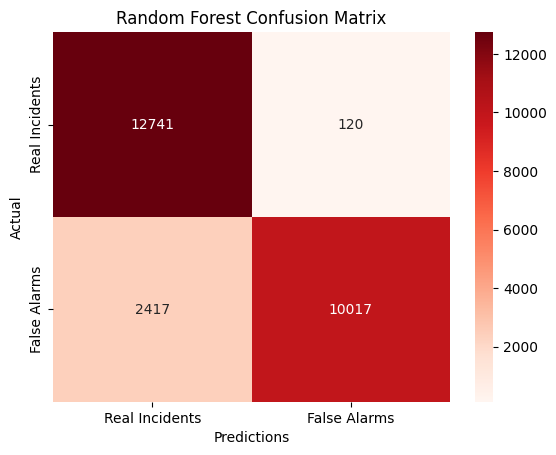

In [66]:
from sklearn.metrics import confusion_matrix

sns.heatmap(
    data = confusion_matrix(y_test, rf.predict(X_test)),
    cmap = 'Reds',
    annot = True,
    fmt = 'g',
    xticklabels = ['Real Incidents','False Alarms'],
    yticklabels = ['Real Incidents','False Alarms'],
).set(
    xlabel = 'Predictions',
    ylabel = 'Actual',
    title = 'Random Forest Confusion Matrix')

<Axes: xlabel='importance', ylabel='features'>

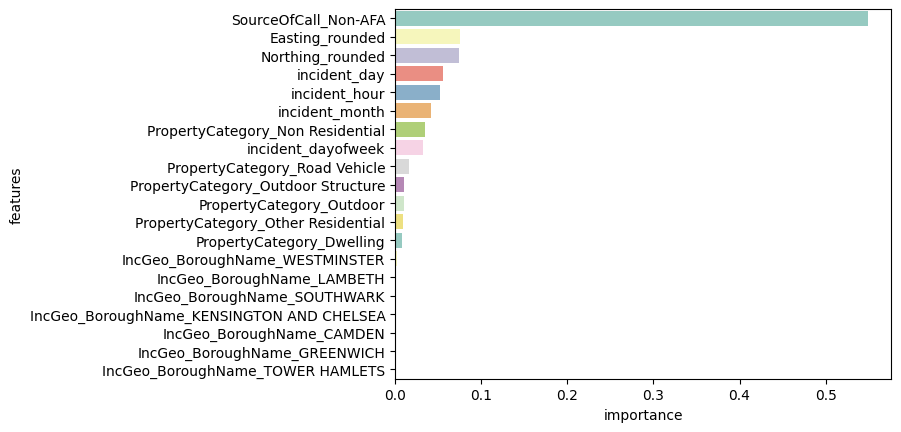

In [67]:
feature_importance = (
    pd.DataFrame({
        'features' : X_train.columns,
        'importance' : rf.feature_importances_
    })
    .sort_values('importance', ascending = False)
)

top_10_features = feature_importance.head(20)
sns.barplot(data = top_10_features, x = 'importance', y= 'features', palette ='Set3')

## 4. Model Improvement

In [ ]:
# Tuning KNN
knn_params = {"n_neighbors": range(1, 50)}

knn_grid = GridSearchCV(KNeighborsClassifier(), knn_params)

knn_grid.fit(X_train_std, y_train)

knn_grid.best_params_

In [72]:
params = 14 #paramters tuning was done in jupyter notebook.hence, i skip this step.
knn_tuned = KNeighborsClassifier(params)

knn_tuned.fit(X_train_std,y_train)

print(f"Training Accuracy: {knn_tuned.score(X_train_std, y_train)}")
print(f"Test Accuracy: {knn_tuned.score(X_test_std, y_test)}")

Training Accuracy: 0.8969330974430948
Test Accuracy: 0.8974896224550306


In [73]:
print(classification_report(y_test, knn_tuned.predict(X_test_std)))

              precision    recall  f1-score   support

           0       0.84      0.99      0.91     12861
           1       0.99      0.80      0.88     12434

    accuracy                           0.90     25295
   macro avg       0.91      0.90      0.90     25295
weighted avg       0.91      0.90      0.90     25295



In [ ]:
#Tuning Random Forest with Randomized Search to narrow down the best parameters

rf = RandomForestClassifier(random_state = 42, n_jobs = -1)

params = {
    'n_estimators' : np.arange(start = 100, stop = 500, step = 100),
    'max_features' : [None, 'sqrt'],
    'max_samples' : [None, .3, .5, .9],
    'max_depth' : np.arange(start = 1, stop = 11, step = 1),
    'min_samples_leaf': [2,5,10,20,100],
}

rs = RandomizedSearchCV(
    rf,
    params,
    n_iter = 100,
    scoring = 'accuracy'
)

rs.fit(X_train,y_train)

rs.best_params_

In [ ]:
rf = RandomForestClassifier(random_state = 42, n_jobs = -1)

params = {
    'n_estimators' : [50,100,150],
     'min_samples_leaf': [4,5,6,7],
     'max_samples': [0.8, 0.9],
     'max_features': [None],
     'max_depth': [10],
}

grid = GridSearchCV(
    rf,
    params,
    scoring = 'accuracy'
)

grid.fit(X_train,y_train)

grid.best_params_

In [76]:
params = {'max_depth': 10,
 'max_features': None,
 'max_samples': 0.8,
 'min_samples_leaf': 7,
 'n_estimators': 50}

rf_tuned = RandomForestClassifier(random_state=42, **params)

rf_tuned.fit(X_train, y_train)

print(f"Training Accuracy: {rf_tuned.score(X_train, y_train)}")
print(f"Test Accuracy: {rf_tuned.score(X_test, y_test)}")

Training Accuracy: 0.8982772764561116
Test Accuracy: 0.9005732358173552


In [77]:
print(classification_report(y_test, rf_tuned.predict(X_test)))

              precision    recall  f1-score   support

           0       0.84      1.00      0.91     12861
           1       1.00      0.80      0.89     12434

    accuracy                           0.90     25295
   macro avg       0.92      0.90      0.90     25295
weighted avg       0.92      0.90      0.90     25295



[Text(0.5, 23.52222222222222, 'Predictions'),
 Text(50.72222222222221, 0.5, 'Actual'),
 Text(0.5, 1.0, 'Tuned Random Forest Confusion Matrix')]

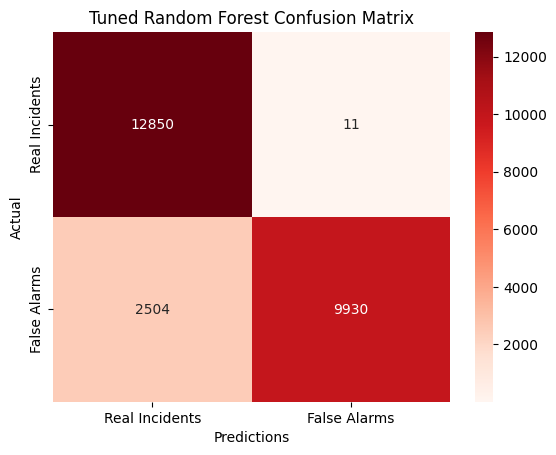

In [78]:
sns.heatmap(
    data = confusion_matrix(y_test, rf_tuned.predict(X_test)),
    cmap = 'Reds',
    annot = True,
    fmt = 'g',
    xticklabels = ['Real Incidents','False Alarms'],
    yticklabels = ['Real Incidents','False Alarms'],
).set(
    xlabel = 'Predictions',
    ylabel = 'Actual',
    title = 'Tuned Random Forest Confusion Matrix')

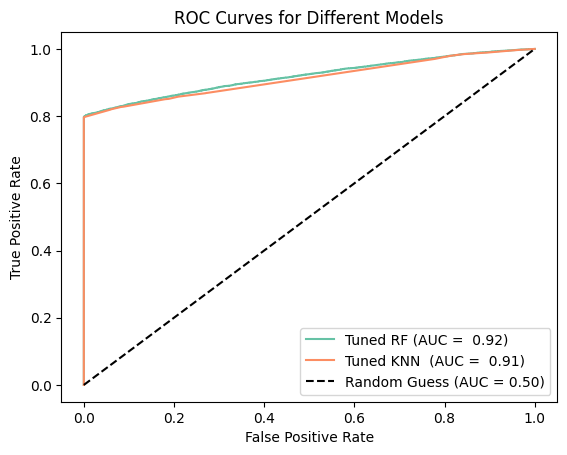

In [79]:
from sklearn.metrics import roc_curve, auc

#Generate ROC AUC for tuned random forest
y_probs = rf_tuned.predict_proba(X_test)[:, 1]
fpr1, tpr1, thresholds = roc_curve(y_test, y_probs)
auc_score1 = auc(fpr1, tpr1)

#Generate ROC AUC for tuned KNN model
y_probs = rf_tuned.predict_proba(X_test_std)[:, 1]
fpr2, tpr2, thresholds = roc_curve(y_test, y_probs)
auc_score2 = auc(fpr2, tpr2)

#Plot the ROC curve

plt.plot(fpr1, tpr1, label = f'Tuned RF (AUC = {auc_score1: .2f})')
plt.plot(fpr2, tpr2, label = f'Tuned KNN  (AUC = {auc_score2: .2f})')

         # Draw Random Guess
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess (AUC = 0.50)')

# Modify Formatting
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Different Models')
plt.legend()
plt.show()

It is evident that Tuned Random Forest outperformed the Tuned KNN model in terms of AUC score.  Increasing the threshold of true positives (false alarms) (up to a certain point indicated by the graph) would not significantly increase the chances of false positives (actual incidents being incorrectly identified as false alarms). The model seems to be performing well in this regard, as indicated by the sharp angle of the curve and the low FPR across a wide range of TPR values.In other words, the model is quite confident in identifying what it considers false alarms without mistakenly classifying actual incidents.